<a href="https://colab.research.google.com/github/sanzgiri/fastpages/blob/master/_notebooks/Single_HDR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This Google Colab Notebook allows you to run the code in https://github.com/alex04072000/SingleHDR which is an implementation of the CVPR 2020 paper "Single-Image HDR Reconstruction by Learning to Reverse the Camera Pipeline", which can be downloaded from https://arxiv.org/abs/2004.01179

- Ashutosh Sanzgiri
sanzgiri@gmail.com


# Setup

In [ ]:
!git clone https://github.com/alex04072000/SingleHDR

In [ ]:
# The versions of packages needed was identified by crawling through github issues
!pip install tensorflow==1.10.0 
!pip install tensorlayer==1.10.1

# After installation restart runtime and continue with the next cell.

In [3]:
# Confirm you have the correct versions
!pip list | grep tensor

tensorboard                   1.10.0         
tensorboard-plugin-wit        1.7.0          
tensorboardcolab              0.0.22         
tensorflow                    1.10.0         
tensorflow-addons             0.8.3          
tensorflow-datasets           2.1.0          
tensorflow-estimator          2.3.0          
tensorflow-gcs-config         2.3.0          
tensorflow-hub                0.9.0          
tensorflow-metadata           0.24.0         
tensorflow-privacy            0.2.2          
tensorflow-probability        0.11.0         
tensorlayer                   1.10.1         


In [ ]:
# This is needed to install the pre-trained models to local
!pip install gdown

In [ ]:
# This is one way to convert HDR files to LDR
# http://pfstools.sourceforge.net/man_pages.html
# http://pfstools.sourceforge.net/man_pages.html
#!sudo apt-get install pfstools
!sudo apt-get install --reinstall pfstools

In [ ]:
# Another option to convert HDR to LDR is ImageMagick
!sudo apt-get install imagemagick

In [ ]:
# Autotone for tonemapping with ImageMagick
!curl -o autotone "http://www.fmwconcepts.com/imagemagick/downloadcounter.php?scriptname=autotone&dirname=autotone"
!chmod +x autotone

In [ ]:
# You can also use OpenCV
!pip install opencv-python-headless

In [53]:
# And this function
# Ref: https://www.learnopencv.com/high-dynamic-range-hdr-imaging-using-opencv-cpp-python/
# https://docs.opencv.org/master/d6/df5/group__photo__hdr.html#gabcbd653140b93a1fa87ccce94548cd0d
# https://docs.opencv.org/4.0.0/d2/df0/tutorial_py_hdr.html
# https://www.toptal.com/opencv/python-image-processing-in-computational-photography

import cv2
import numpy as np
from cv2 import createTonemapDrago, createTonemapMantiuk, createTonemapReinhard, createTonemap

def convert_hdr(hdrfile, ldrfile, tm_choice="D", val=2.2):

  im = cv2.imread(hdrfile, cv2.IMREAD_ANYDEPTH)
  
  if tm_choice == "D":
    tonemap = createTonemapDrago(gamma=val, bias=0.85)
  elif tm_choice == "M":
    tonemap = createTonemapMantiuk(gamma=val, scale=0.75)
  elif tm_choice == "R":
    tonemap = createTonemapReinhard(gamma=val)
  else:
    tonemap = createTonemap(gamma=val)

  ldr = tonemap.process(im)
  im2_8bit = np.clip(ldr * 255, 0, 255).astype('uint8')
  cv2.imwrite(ldrfile, im2_8bit)

In [ ]:
# This is for plotting images side by side
!pip install ipyplot

In [20]:
cd SingleHDR

/content/SingleHDR/SingleHDR


In [ ]:
# Download models and unzip
!gdown https://drive.google.com/uc?id=1e9vP8YPEjGcvXCa0Bfqwxw7qks7dH-VE
!unzip -o ckpt.zip

# Run test example using model trained on synthetic data

In [ ]:
# Run test example (model trained only on synthetic data)
# Ignore the tmalloc errors
# Note output file has .hdr extension, some image viewers like Mac Preview can open it. You can convert it to .png as shown below 

!CUDA_VISIBLEDEVICES=0 python3 test_real.py --ckpt_path_deq ckpt_deq/model.ckpt \
                                            --ckpt_path_lin ckpt_lin/model.ckpt \
                                            --ckpt_path_hal ckpt_hal/model.ckpt \
                                            --test_imgs ./imgs \
                                            --output_path output_hdrs

In [23]:
# Original image
!ls -l imgs

total 2892
-rw-r--r-- 1 root root 2961073 Sep 25 22:35 00000.png


In [24]:
# HDR version
!ls -l output_hdrs

total 5544
-rw-r--r-- 1 root root 5676415 Sep 25 22:38 00000.hdr


# Explore various ways to convert HDR to LDR

In [27]:
# Convert HDR to PNG using pfstools
!pfsin output_hdrs/00000.hdr | pfstmo_drago03 | pfsout output_hdrs/00000_hdr_pfs.png

In [87]:
# Convert HDR image to PNG using imagemagick
!convert output_hdrs/00000.hdr output_hdrs/00000_hdr_im.png
# Autotone it!
!./autotone output_hdrs/00000.hdr output_hdrs/00000_hdr_im.png

In [55]:
# Convert HDR image to PNG using openCV
convert_hdr('output_hdrs/00000.hdr', 'output_hdrs/00000_hdr_cv_d.png', 'D', 2.2)
convert_hdr('output_hdrs/00000.hdr', 'output_hdrs/00000_hdr_cv_m.png', 'M', 2.2)
convert_hdr('output_hdrs/00000.hdr', 'output_hdrs/00000_hdr_cv_r.png', 'R', 2.2)
convert_hdr('output_hdrs/00000.hdr', 'output_hdrs/00000_hdr_cv_u.png', 'U', 2.2)

# Comparisons

## PFSTools


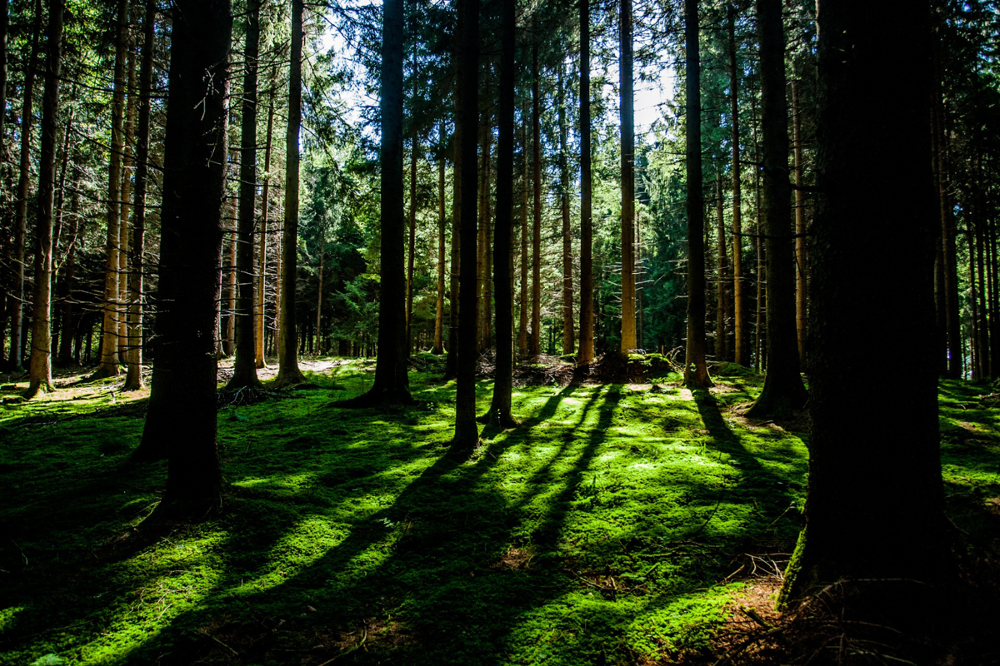
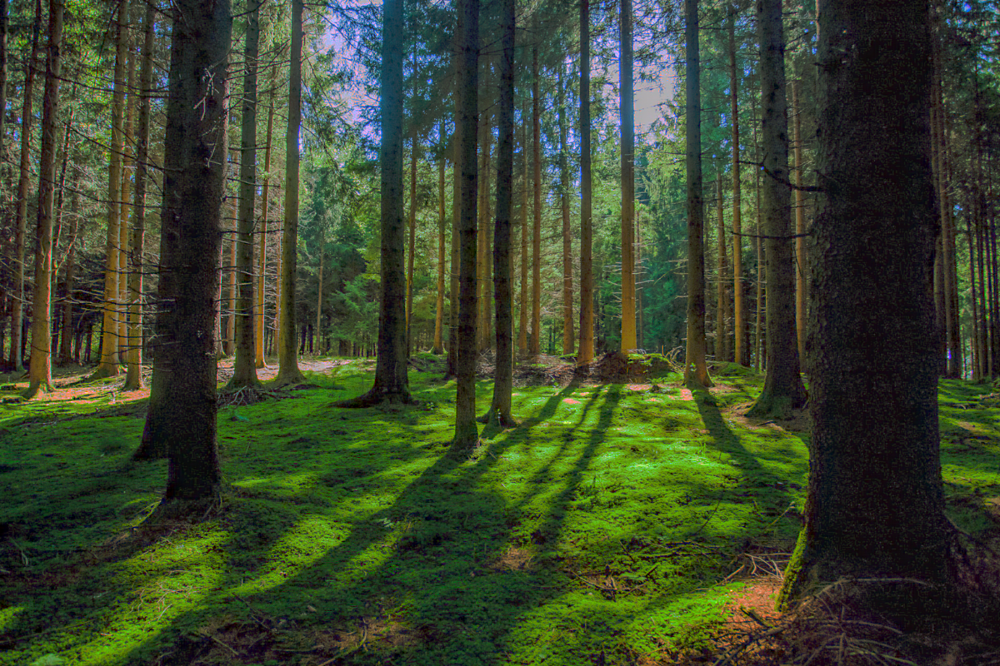

In [56]:
# Compare original with HDR version
import ipyplot
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_pfs.png'], max_images=2, img_width=600, force_b64=True)

## ImageMagick with Autotone is the best choice!


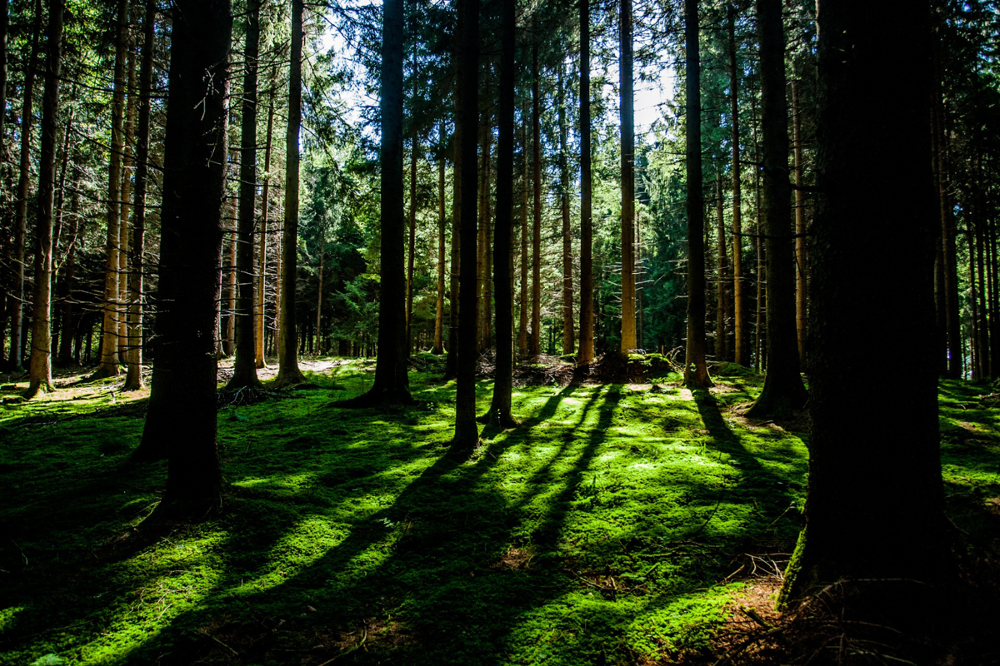
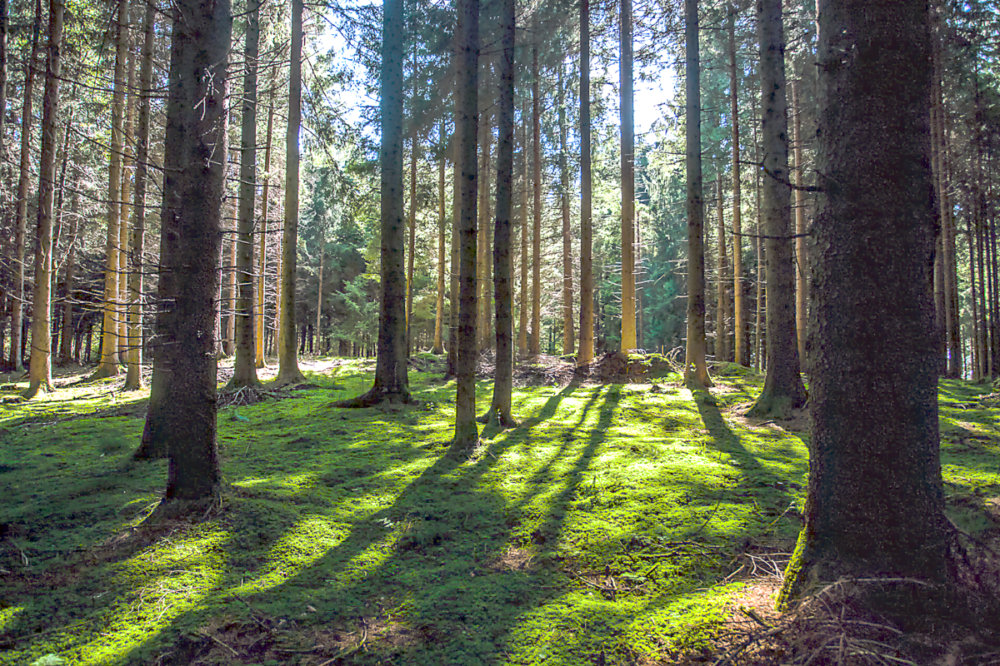

In [88]:
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_im.png'], max_images=2, img_width=600, force_b64=True)

## OpenCV options


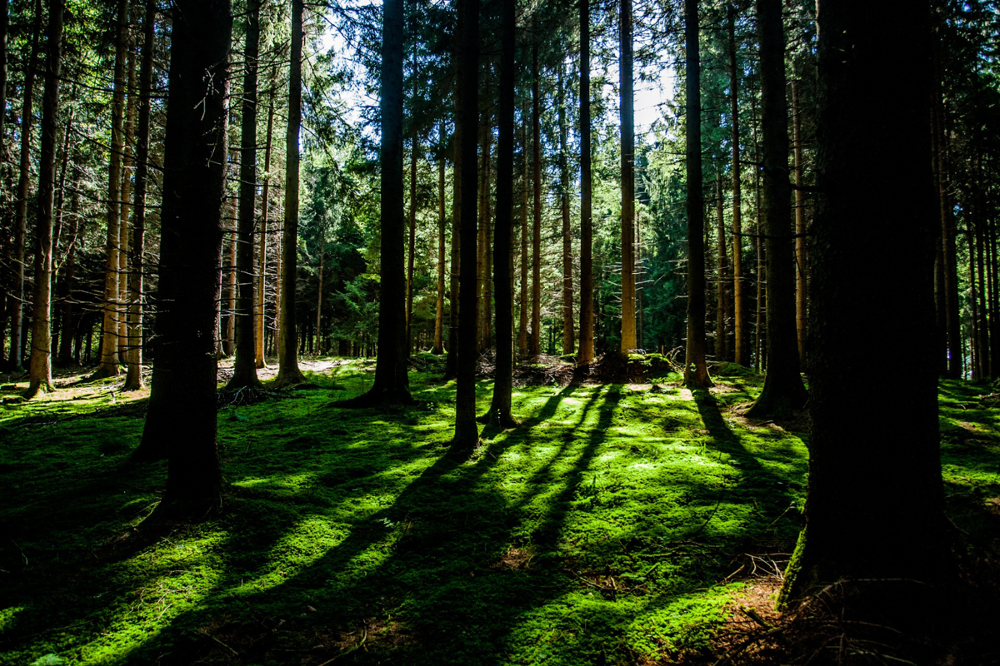
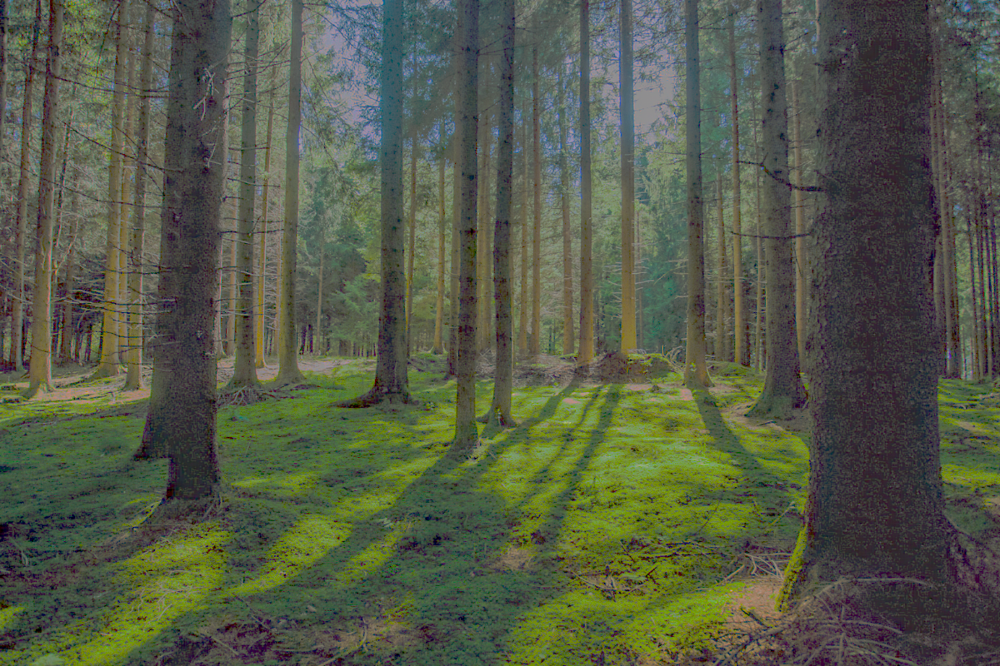

In [57]:
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_cv_d.png'], max_images=2, img_width=600, force_b64=True)


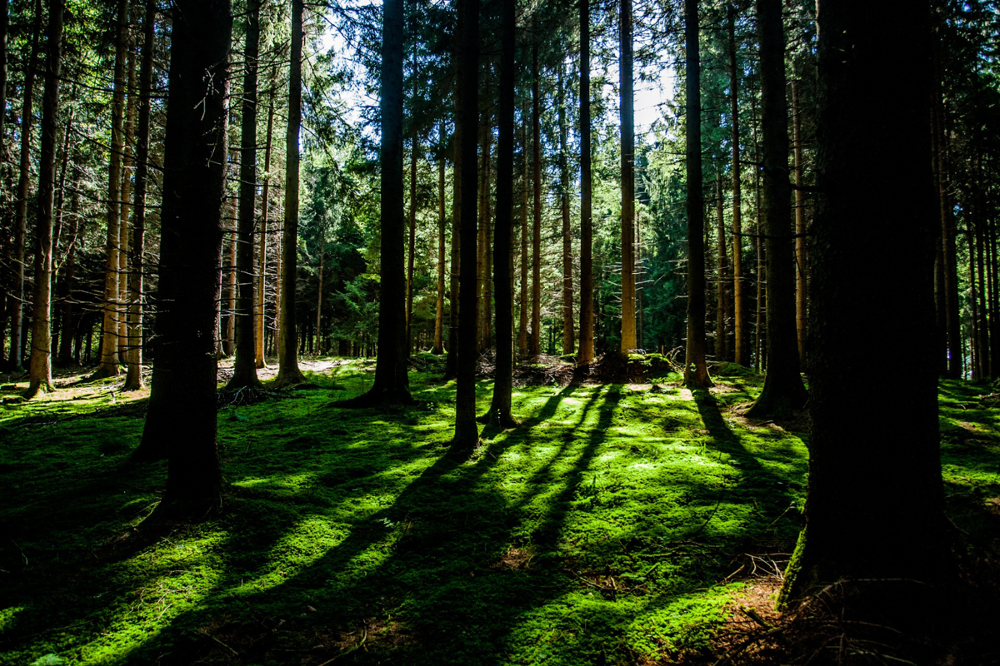
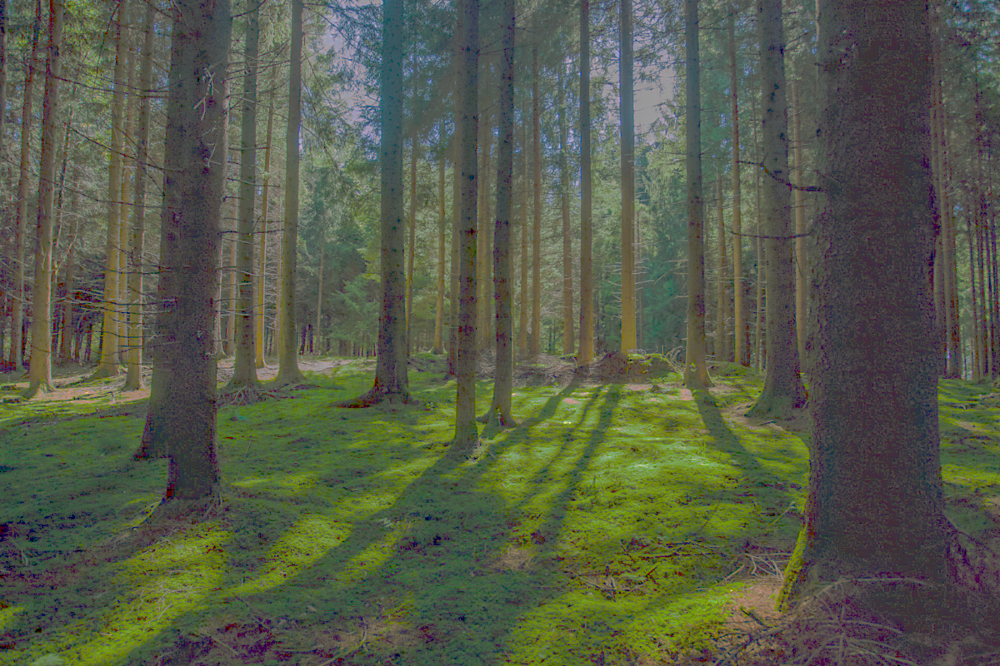

In [58]:
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_cv_m.png'], max_images=2, img_width=600, force_b64=True)


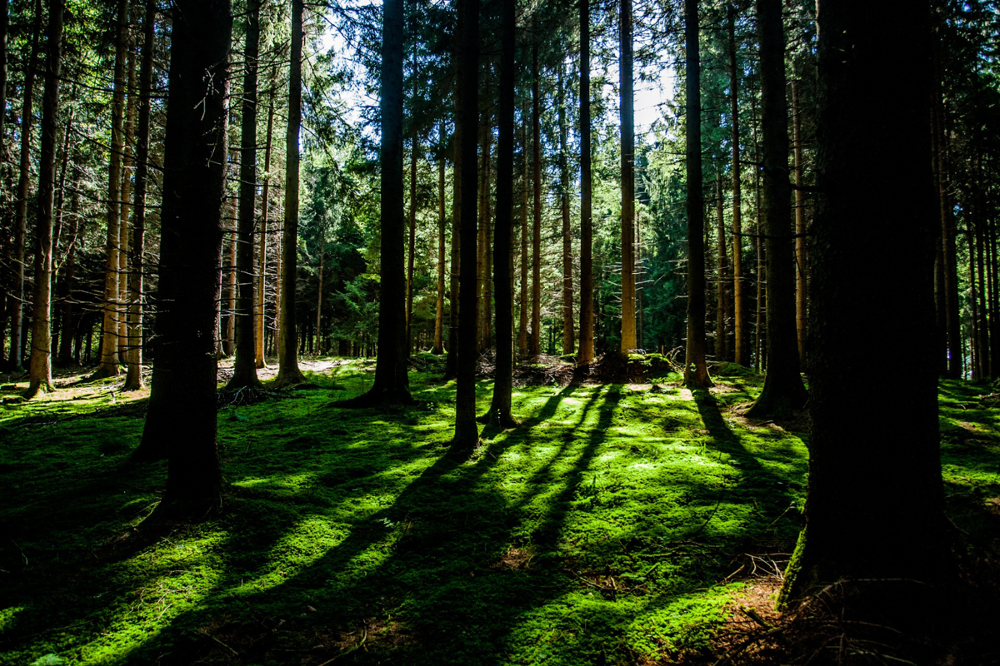
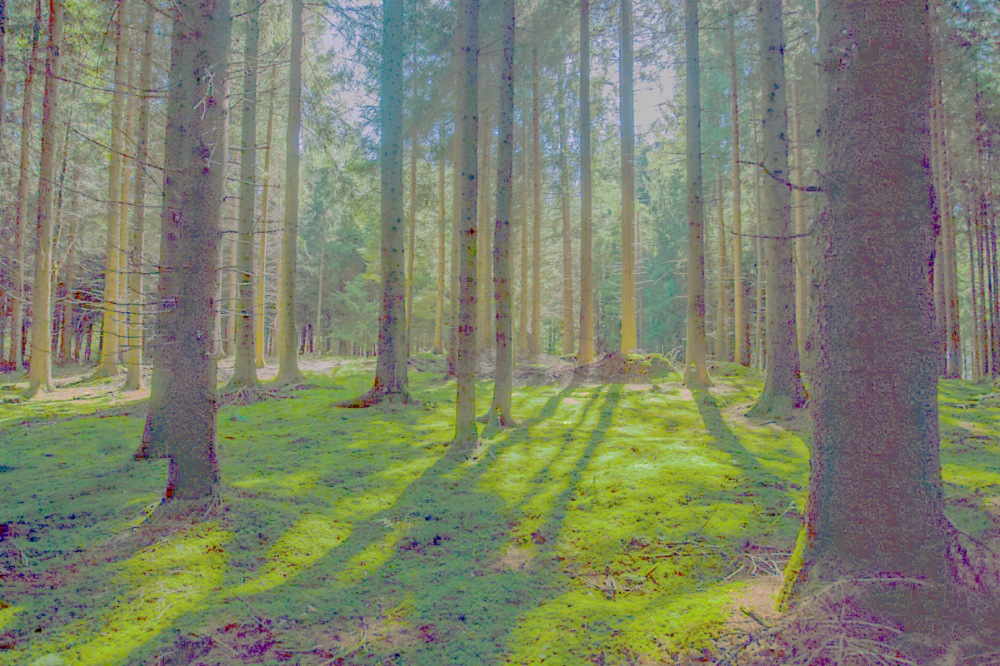

In [59]:
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_cv_r.png'], max_images=2, img_width=600, force_b64=True)


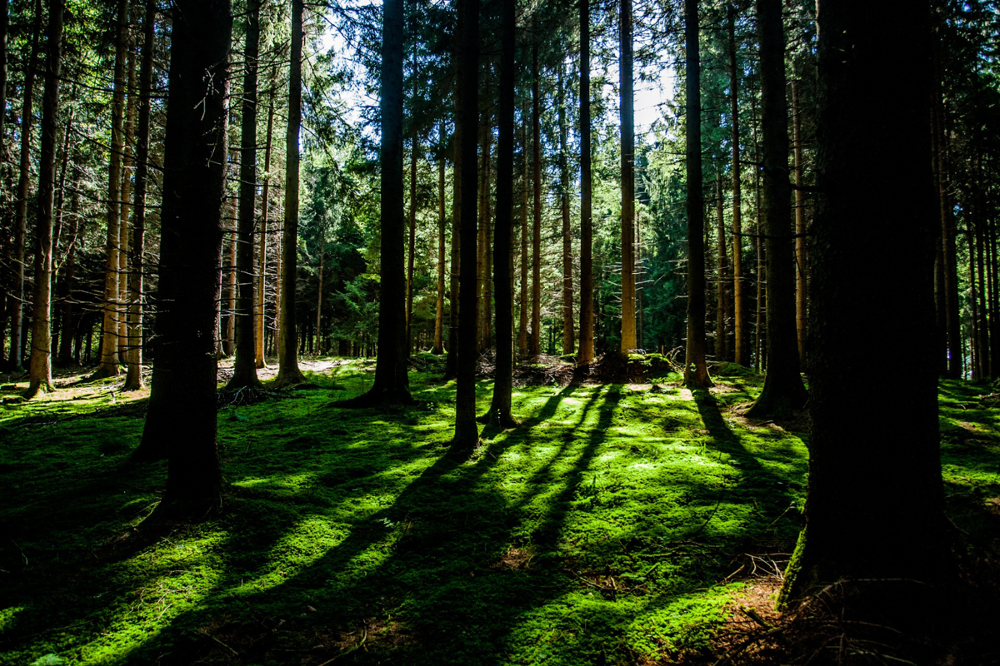
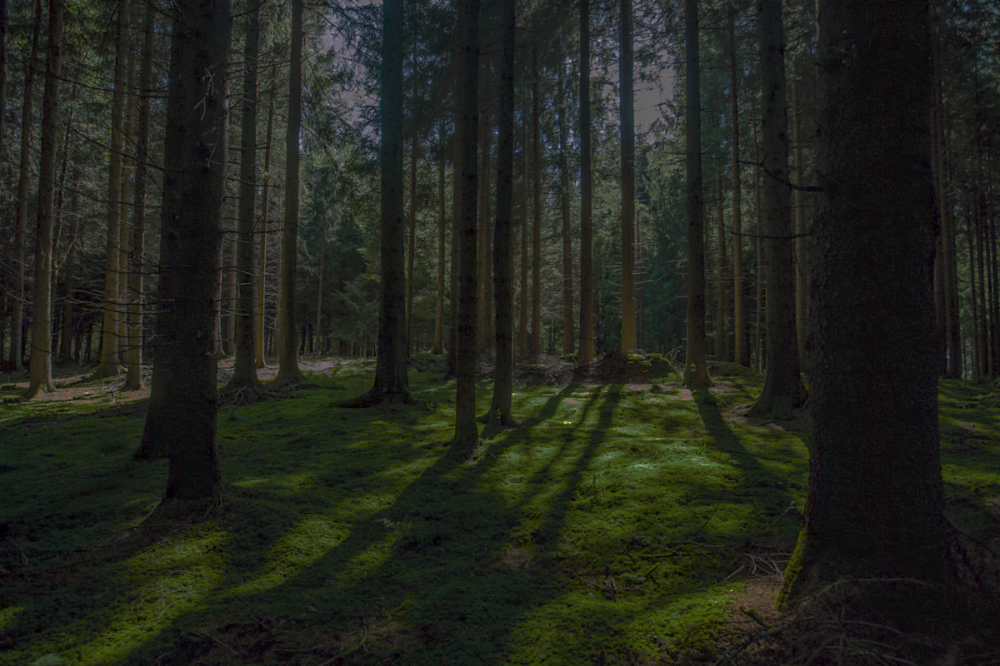

In [60]:
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs/00000_hdr_cv_u.png'], max_images=2, img_width=600, force_b64=True)

# Run test example on model trained with Real + Synthetic data


In [ ]:
# Run test example (model trained only on real + synthetic data)
# Ignore the tmalloc errors
# Note output file has .hdr extension, but can be opened by image viewer such as preview

# this is better quality

!CUDA_VISIBLEDEVICES=0 python3 test_real_refinement.py --ckpt_path ckpt_deq_lin_hal_ref/model.ckpt \
                                                       --test_imgs ./imgs \
                                                       --output_path output_hdrs2


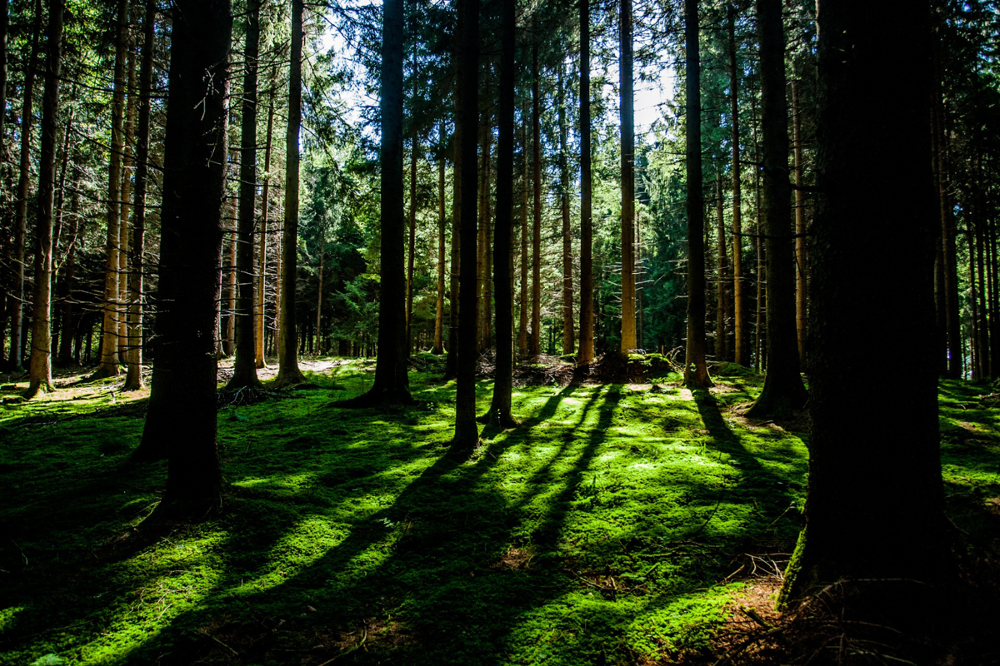
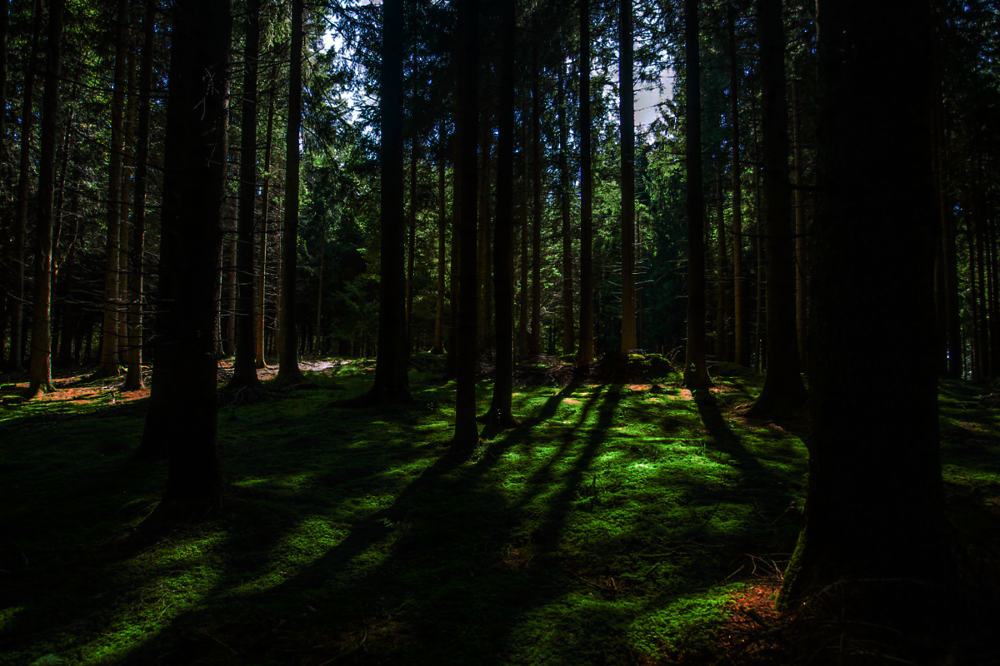

In [17]:
!pfsin output_hdrs2/00000.hdr | pfstmo_drago03| pfsout output_hdrs2/00000_hdr.png
ipyplot.plot_images(['imgs/00000.png', 'output_hdrs2/00000_hdr.png'], max_images=2, img_width=600, force_b64=True)

# Upload your own file now

In [89]:
!mkdir -p uploads
!mv /landscape.png uploads

In [ ]:
!CUDA_VISIBLEDEVICES=0 python3 test_real_refinement.py --ckpt_path ckpt_deq_lin_hal_ref/model.ckpt \
                                                       --test_imgs ./uploads \
                                                       --output_path output_hdrs


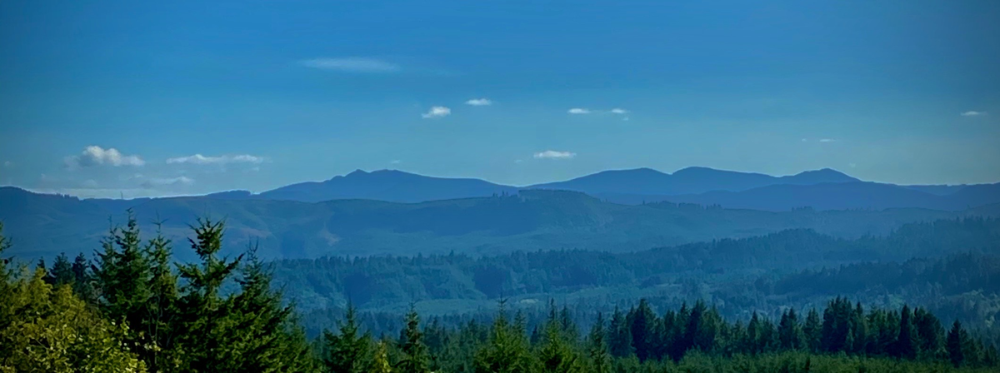
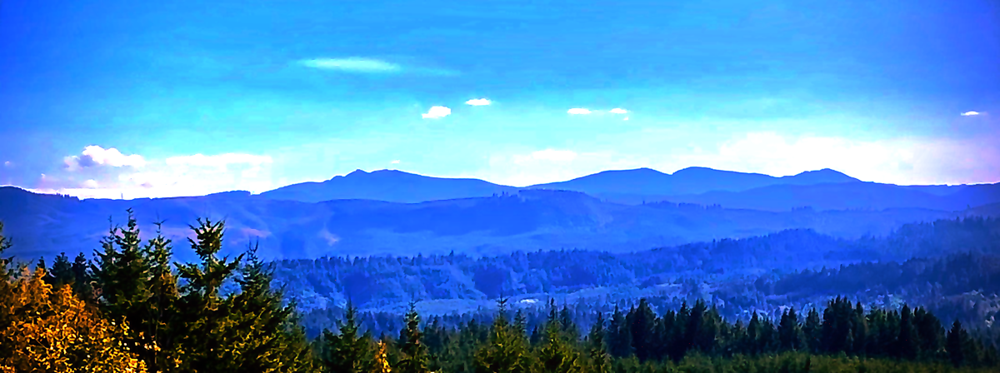

In [96]:
# Convert to HDR & Autotone it!
!./autotone output_hdrs/landscape.hdr output_hdrs/landscape_hdr_im.png
ipyplot.plot_images(['uploads/landscape.png', 'output_hdrs/landscape_hdr_im.png'], max_images=2, img_width=600, force_b64=True)


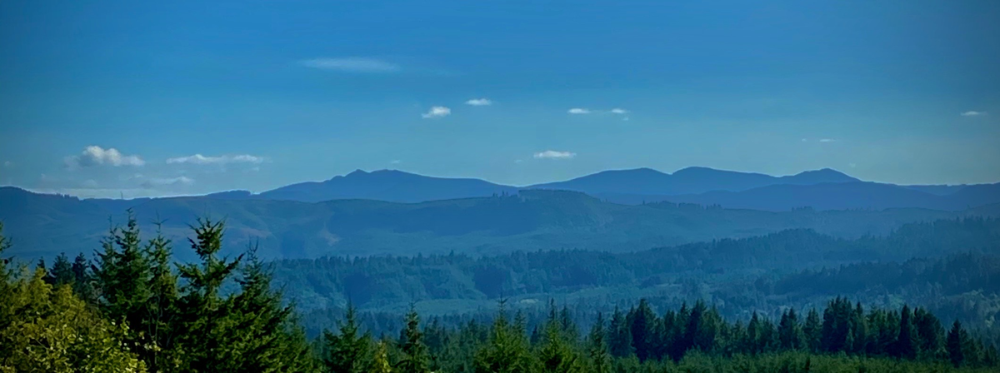
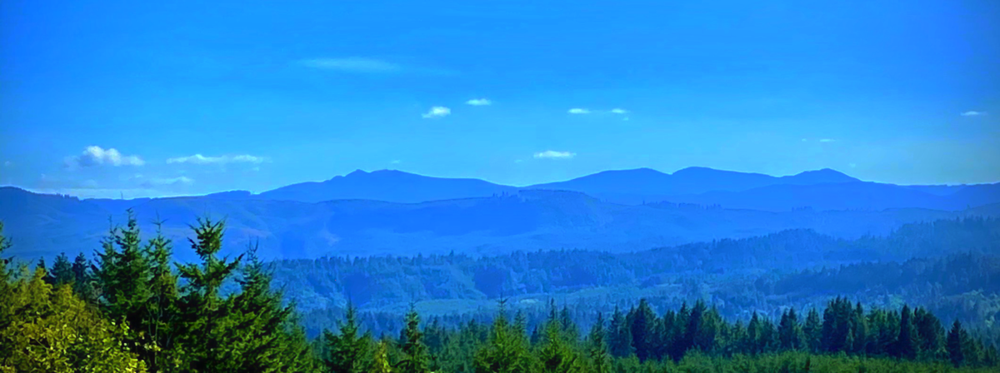

In [97]:
# Convert HDR to PNG using pfstools
!pfsin output_hdrs/landscape.hdr | pfstmo_drago03 | pfsout output_hdrs/landscape_hdr_pfs.png
ipyplot.plot_images(['uploads/landscape.png', 'output_hdrs/landscape_hdr_pfs.png'], max_images=2, img_width=600, force_b64=True)


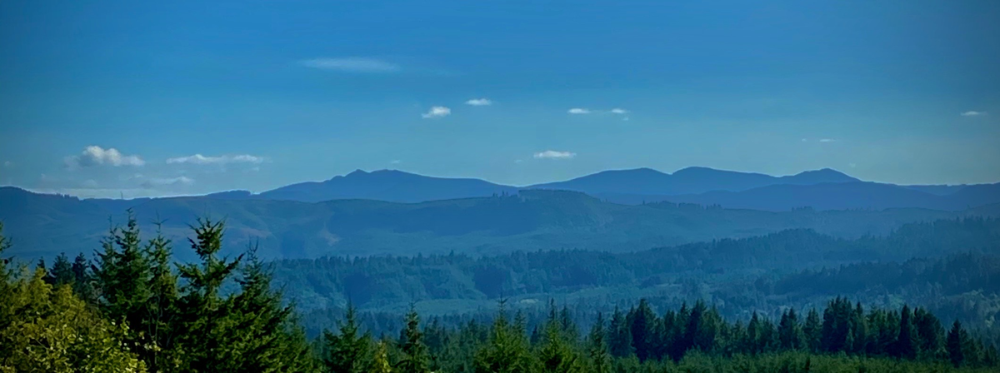
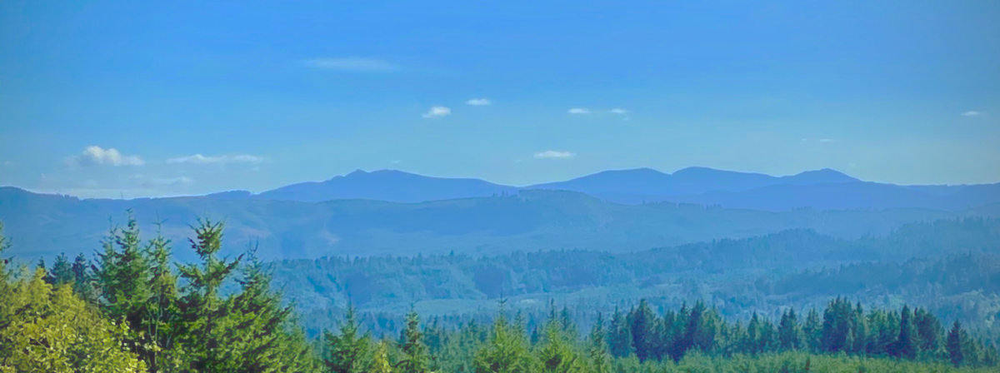


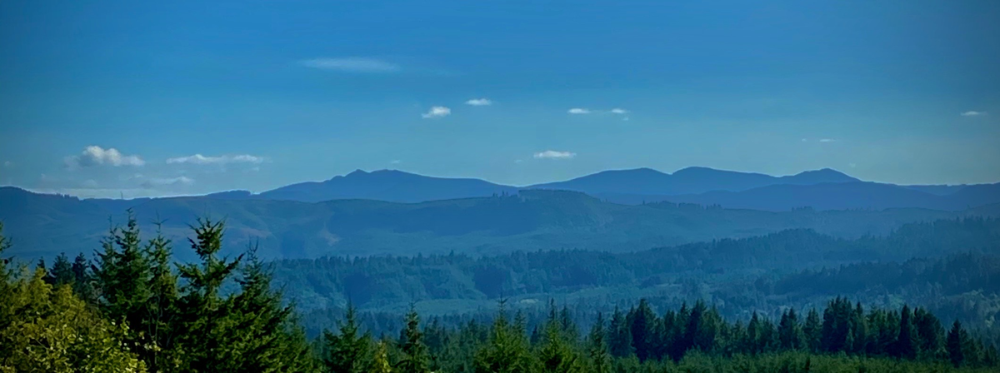
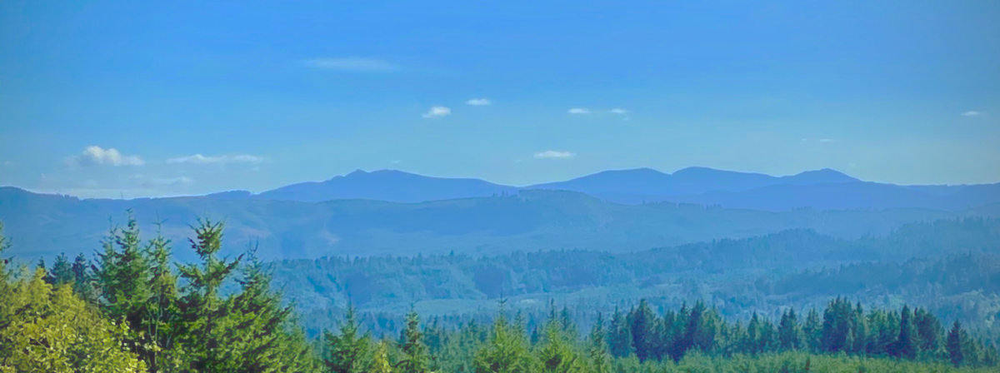


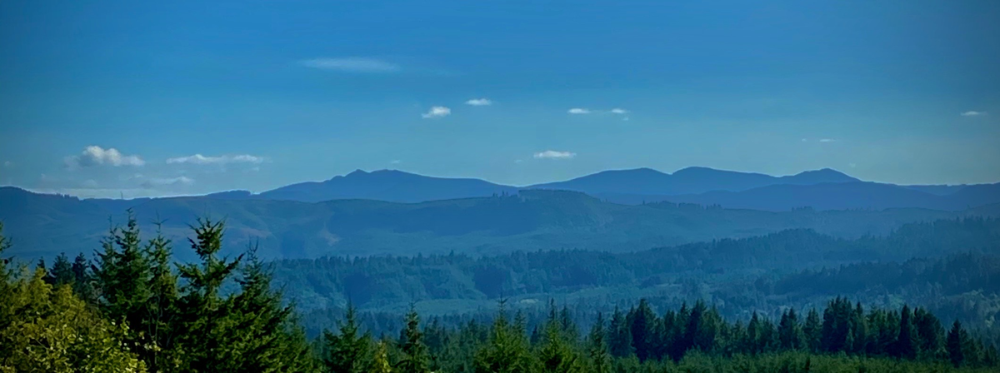
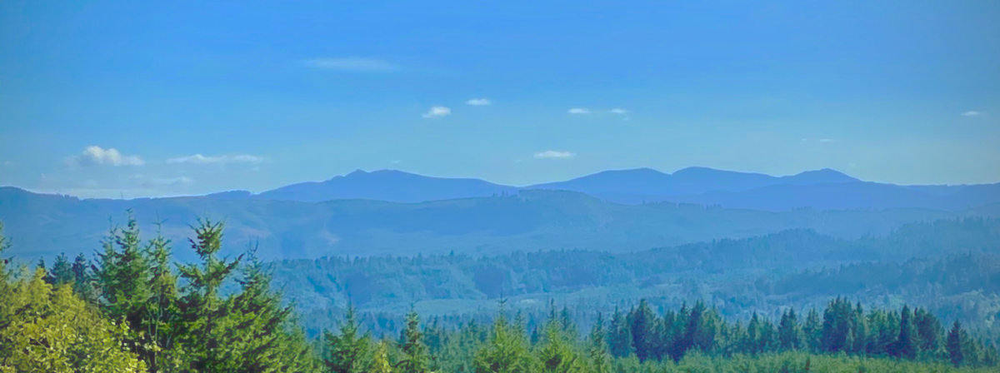


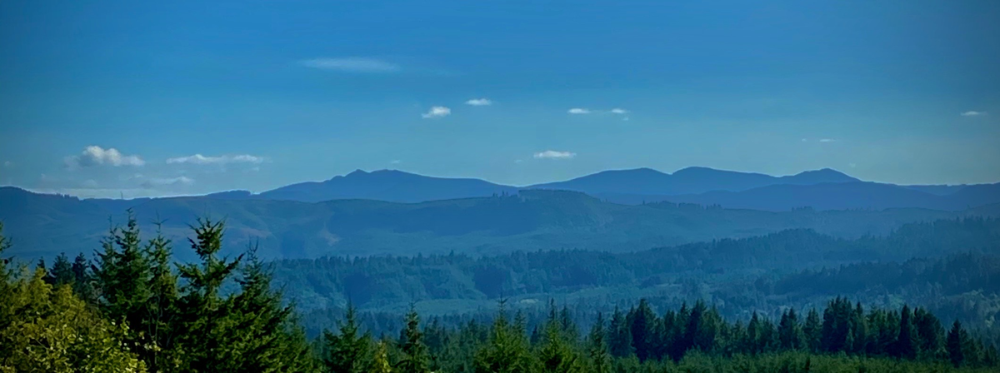
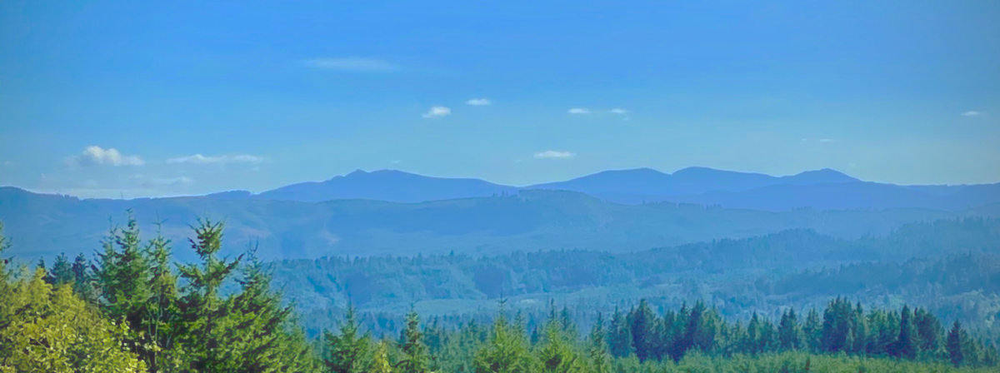

In [99]:
# Convert HDR image to PNG using opencv
origfile = 'uploads/landscape.png'
hdrfile = 'output_hdrs/landscape.hdr'
for tonemap in ['D', 'M', 'R', 'U']:
  outfile = f'output_hdrs/landscape_hdr_cv_{tonemap}.png'
  convert_hdr(hdrfile, outfile, 'D', 2.2)
  ipyplot.plot_images([origfile, outfile], max_images=2, img_width=600, force_b64=True)
